# CS 5814 Homework 4, Part 1: Generative Adversarial Networks

In [1]:
# from google.colab import drive
# drive.mount('/content/drive')

In [2]:
import os
# os.chdir("/content/drive/MyDrive/Colab Notebooks/Intro to DL Course/HW4/hw4/part1")
path = os.getcwd()
path

'/home/nima/RAMIN/HW4/Part1'

In [3]:
import torch
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder
import matplotlib.pyplot as plt
import numpy as np

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

%load_ext autoreload
%autoreload 2

In [4]:
from gan.train import train

In [5]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [6]:
device

device(type='cuda', index=0)

# GAN loss functions

You'll need to implement two different loss functions. The first is the loss from the [original GAN paper](https://arxiv.org/pdf/1406.2661.pdf). The next is the loss from [LS-GAN](https://arxiv.org/abs/1611.04076).

### GAN loss

**TODO:** You need to implement the `discriminator_loss` and `generator_loss` functions in `gan/losses.py`.

The generator loss is given by:
$$\ell_G  =  -\mathbb{E}_{z \sim p(z)}\left[\log D(G(z))\right]$$
and the discriminator loss is:
$$ \ell_D = -\mathbb{E}_{x \sim p_\text{data}}\left[\log D(x)\right] - \mathbb{E}_{z \sim p(z)}\left[\log \left(1-D(G(z))\right)\right]$$

Note that these equations are negated because we will be *minimizing* these losses.

**HINTS**: Use the `torch.nn.functional.binary_cross_entropy_with_logits` function to compute the binary cross entropy loss since it is more numerically stable than using a softmax followed by BCE loss.

We will be averaging over the elements of the minibatch instead of computing the expectation of $\log D(G(z))$, $\log D(x)$ and $\log \left(1-D(G(z))\right)$.

In [7]:
from gan.losses import discriminator_loss, generator_loss

### Least Squares GAN loss

**TODO:** You need to implement the `ls_discriminator_loss` and `ls_generator_loss` functions in `gan/losses.py`.

[Least Squares GAN](https://arxiv.org/abs/1611.04076) is an alernative to the original GAN loss function.
For this part, all you need to do change the loss function and retrain the model.

Specifically, you'll implement equation (9) in the paper:
$$\ell_G  =  \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[\left(D(G(z))-1\right)^2\right]$$
and the discriminator loss:
$$ \ell_D = \frac{1}{2}\mathbb{E}_{x \sim p_\text{data}}\left[\left(D(x)-1\right)^2\right] + \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[ \left(D(G(z))\right)^2\right]$$

In [8]:
from gan.losses import ls_discriminator_loss, ls_generator_loss

# GAN model architecture

**TODO:** Next, you'll need to implement the `Discriminator` and `Generator` networks in `gan/models.py`.

We'll be using the architecture from [DCGAN](https://arxiv.org/pdf/1511.06434.pdf):

**Discriminator:**

- convolutional layer with in_channels=3, out_channels=128, kernel=4, stride=2
- convolutional layer with in_channels=128, out_channels=256, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=256, out_channels=512, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=512, out_channels=1024, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=1024, out_channels=1, kernel=4, stride=1

Use padding = 1 (not 0) for all the convolutional layers.

You can either use LeakyReLu throughout the discriminator (and a negative slope value of 0.2) or just use relu.

The discriminator will output a single score for each sample.The output of your discriminator should be a single value score corresponding to each input sample.


**Generator:**

**Note:** Here, you'll need to use transposed convolution (sometimes known as fractionally-strided convolution). This function is implemented in pytorch as `torch.nn.ConvTranspose2d`.

- transpose convolution with in_channels=NOISE_DIM, out_channels=1024, kernel=4, stride=1
- batch norm
- transpose convolution with in_channels=1024, out_channels=512, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=512, out_channels=256, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=256, out_channels=128, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=128, out_channels=3, kernel=4, stride=2

The generator network will need to map the output values between -1 and 1 using a `tanh` nonlinearity. The output should be of size 64x64 with 3 channels for each sample (equal dimensions to the images from the dataset).

In [9]:
from gan.models import Discriminator, Generator

# Data loading

Our dataset is pretty small, so in order to prevent overfitting, we need to perform data augmentation.

**TODO:** You'll need to implement some data augmentation by adding new transforms to the cell below.

The easiest you can do is just use the RandomCrop and ColorJitter, but feel free to play around with other augmentations as well to see how it affects the performance of your model. See https://pytorch.org/vision/stable/transforms.html.

In [10]:
# # Define the transform for the training data.
# transform = transforms.Compose([
#     transforms.RandomResizedCrop(64, scale=(0.8, 1.0), ratio=(0.95, 1.05)),  # Randomly crop and resize the image to 64x64.
#     transforms.RandomHorizontalFlip(),  # Randomly flip the image horizontally.
#     transforms.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1),  # Randomly change the brightness, contrast, and saturation of the image.
#     transforms.ToTensor(),  # Convert the image to a PyTorch tensor.
#     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),  # Normalize the image.
# ])


In [11]:
print(os.path.exists('./cats'))  # This should return True if the directory exists


True


In [12]:
!ls

cats  cats.zip	gan  part1.ipynb  part1.pdf


In [13]:
batch_size = 32
imsize = 64
cat_root = './cats'

cat_train = ImageFolder(root=cat_root, transform=transforms.Compose([
  transforms.ToTensor(),
  transforms.RandomResizedCrop(64, scale=(0.8, 1.0), ratio=(0.95, 1.05)),  # Randomly crop and resize the image to 64x64.
  transforms.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1),  # Randomly change the brightness, contrast, and saturation of the image.
  # transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),  # Normalize the image.

    ## Use some some augmentations here

]))

cat_loader_train = DataLoader(cat_train, batch_size=batch_size, drop_last=True)

In [14]:
len(cat_train)

15747

### Visualize dataset

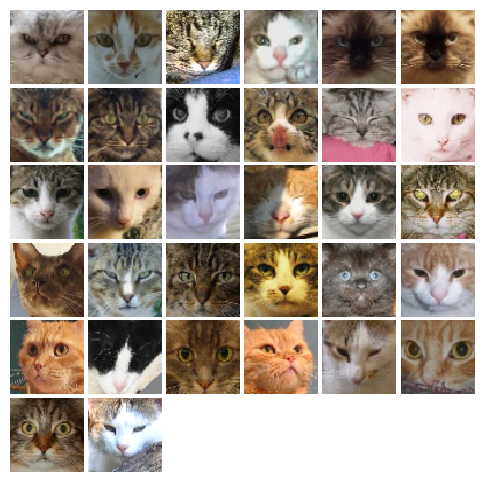

In [15]:
from gan.utils import show_images

# imgs = cat_loader_train.__iter__().next()[0].numpy().squeeze()
imgs = next(iter(cat_loader_train))[0].numpy().squeeze()
show_images(imgs, color=True)

# Training


**TODO:** You need to write the training loop in `gan/train.py`.

In [16]:
NOISE_DIM = 100
NUM_EPOCHS = 50
learning_rate = 0.001

### Train GAN

In [17]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [18]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

In [19]:
from gan.train import train

EPOCH:  1
Iter: 0, D: 0.6989, G:5.36


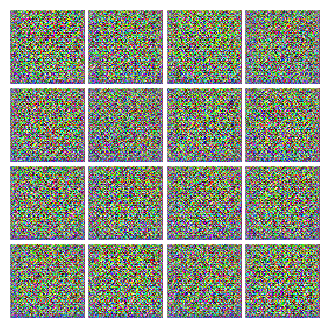


Iter: 250, D: 0.7678, G:2.752


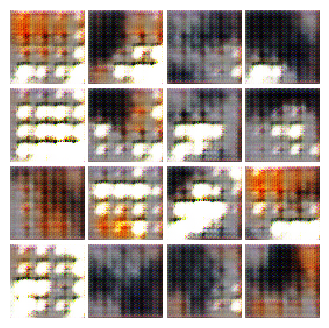


EPOCH:  2
Iter: 500, D: 0.5115, G:3.44


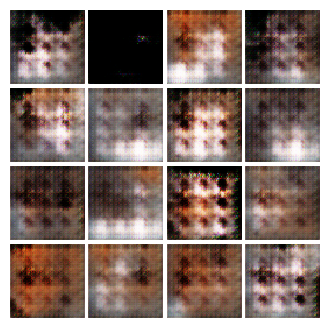


Iter: 750, D: 0.7622, G:1.177


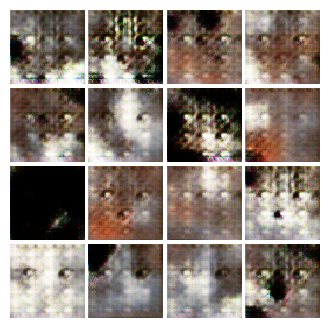


EPOCH:  3
Iter: 1000, D: 0.6193, G:2.908


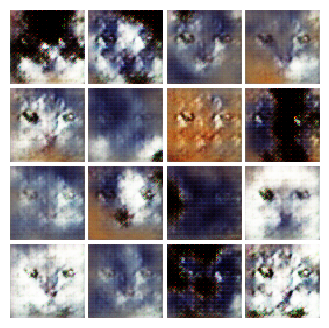


Iter: 1250, D: 0.5258, G:3.034


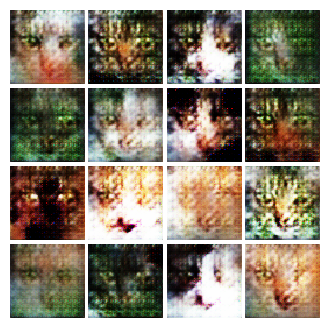


EPOCH:  4
Iter: 1500, D: 0.5868, G:1.919


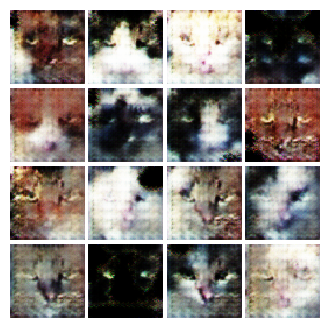


Iter: 1750, D: 0.9196, G:3.262


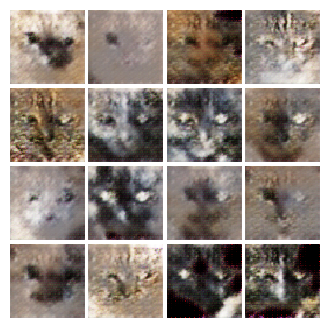


EPOCH:  5
Iter: 2000, D: 0.4012, G:1.243


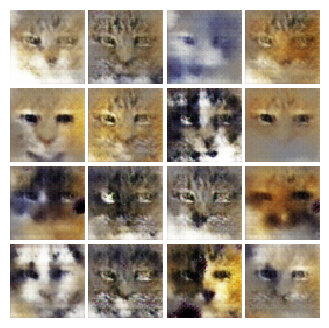


Iter: 2250, D: 0.7639, G:4.109


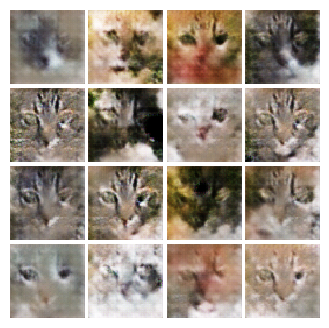


EPOCH:  6
Iter: 2500, D: 0.4538, G:2.275


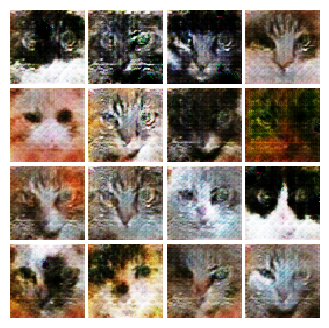


Iter: 2750, D: 0.4543, G:1.707


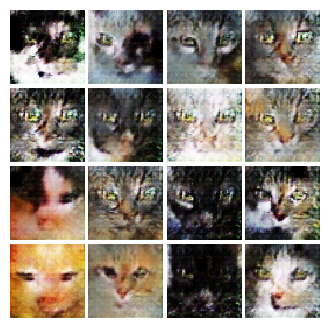


EPOCH:  7
Iter: 3000, D: 0.4874, G:4.03


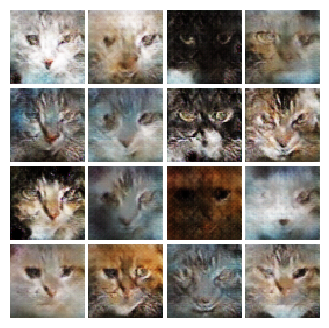


Iter: 3250, D: 0.383, G:1.46


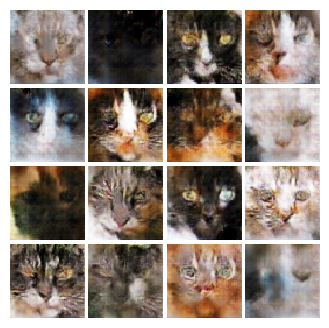


EPOCH:  8
Iter: 3500, D: 0.4067, G:2.063


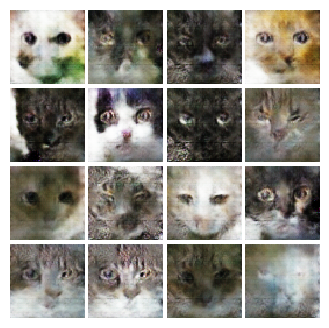


Iter: 3750, D: 0.2759, G:2.477


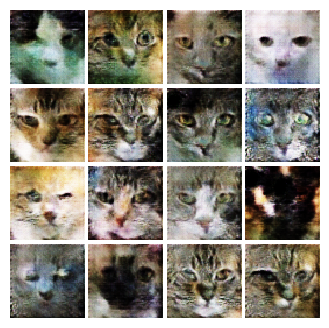


EPOCH:  9
Iter: 4000, D: 0.3569, G:3.823


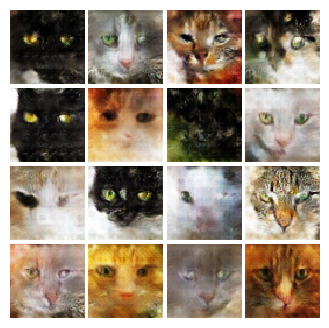


Iter: 4250, D: 0.5635, G:2.444


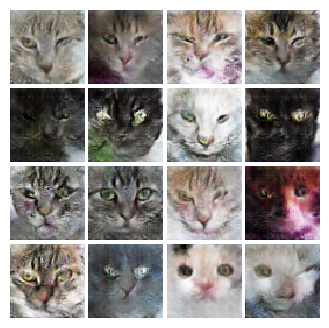


EPOCH:  10
Iter: 4500, D: 0.3934, G:3.918


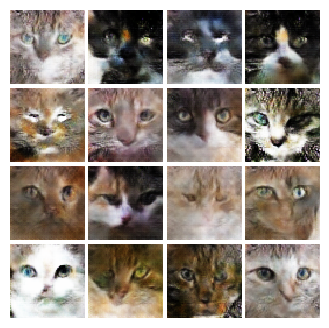


Iter: 4750, D: 0.1734, G:3.376


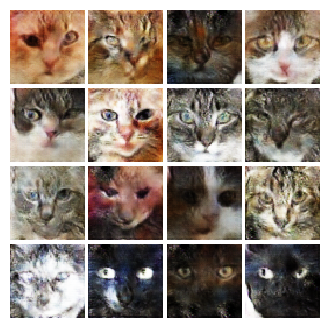


EPOCH:  11
Iter: 5000, D: 0.2954, G:4.71


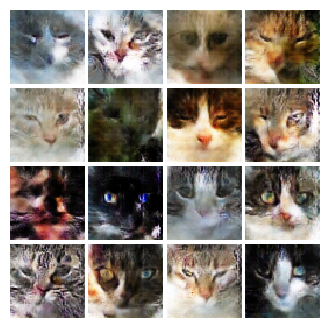


Iter: 5250, D: 0.2073, G:2.051


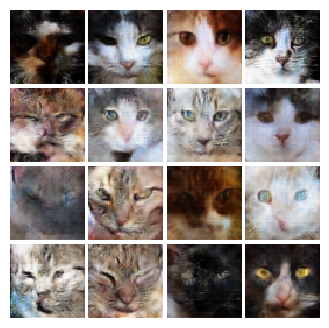


EPOCH:  12
Iter: 5500, D: 0.5095, G:6.134


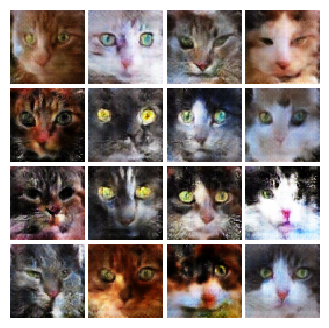


Iter: 5750, D: 0.1146, G:5.346


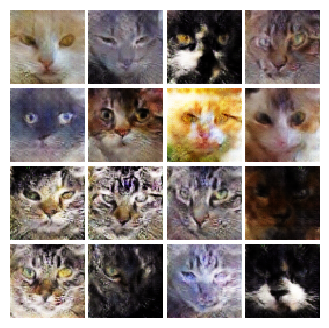


EPOCH:  13
Iter: 6000, D: 0.2179, G:4.989


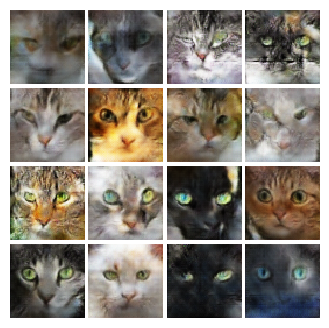


Iter: 6250, D: 0.1493, G:2.715


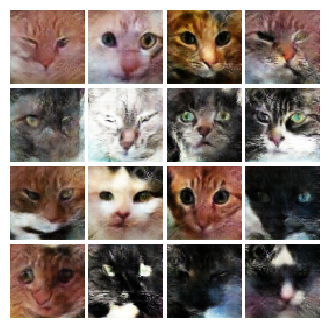


EPOCH:  14
Iter: 6500, D: 0.05924, G:4.703


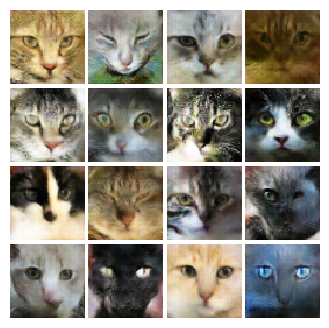


Iter: 6750, D: 0.3867, G:5.044


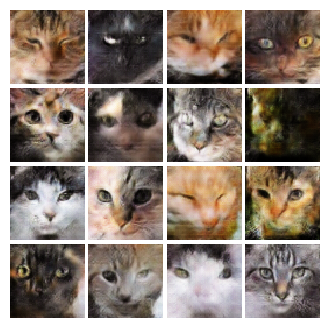


EPOCH:  15
Iter: 7000, D: 0.05015, G:2.492


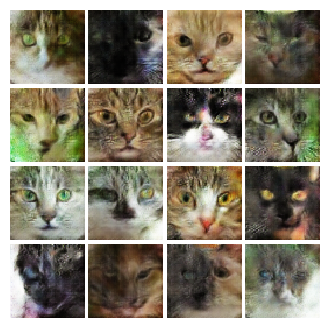


Iter: 7250, D: 0.06222, G:3.605


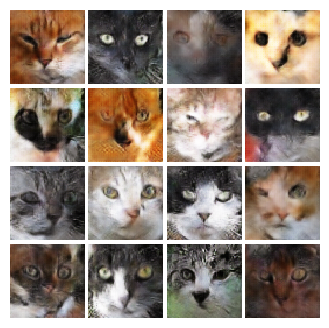


EPOCH:  16
Iter: 7500, D: 0.05025, G:4.111


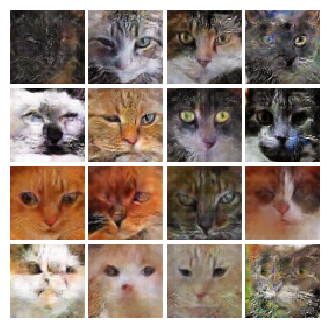


Iter: 7750, D: 0.1586, G:4.09


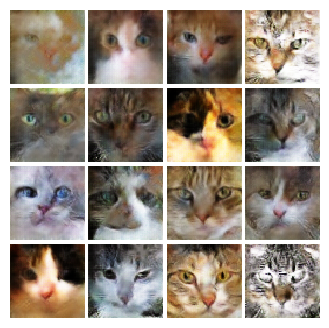


EPOCH:  17
Iter: 8000, D: 0.09757, G:6.224


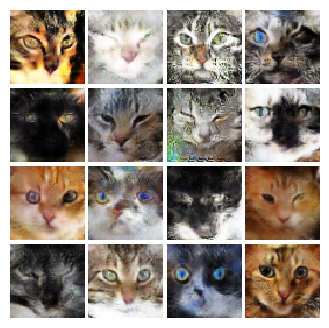


Iter: 8250, D: 0.1554, G:5.703


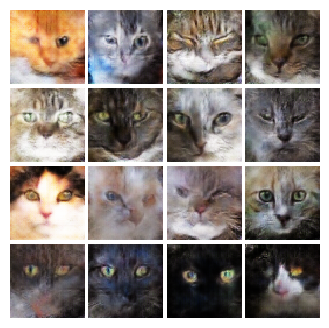


EPOCH:  18
Iter: 8500, D: 0.0415, G:7.083


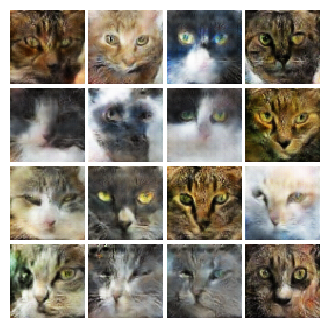


Iter: 8750, D: 0.07817, G:3.421


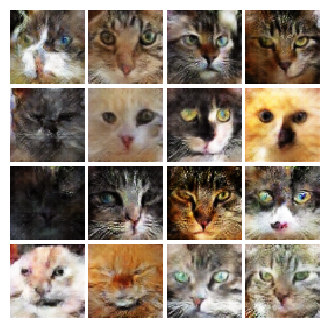


EPOCH:  19
Iter: 9000, D: 0.06559, G:6.079


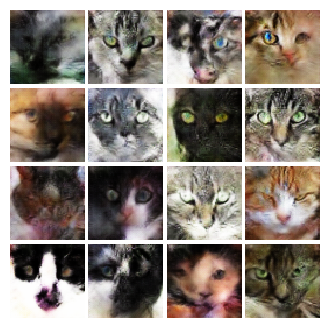


Iter: 9250, D: 0.1885, G:7.056


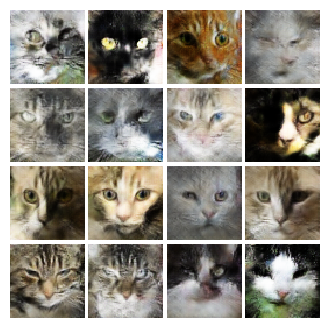


EPOCH:  20
Iter: 9500, D: 0.06735, G:4.865


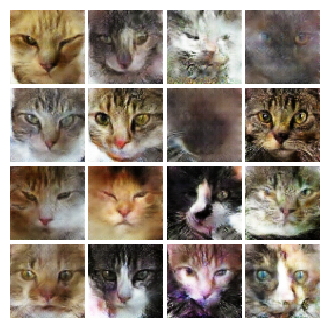


Iter: 9750, D: 0.06368, G:4.503


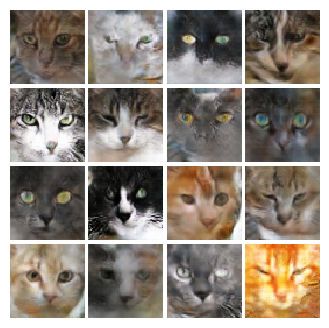


EPOCH:  21
Iter: 10000, D: 0.2638, G:2.658


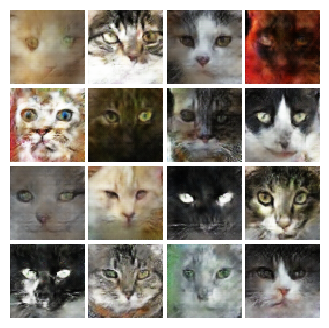


Iter: 10250, D: 0.0411, G:4.532


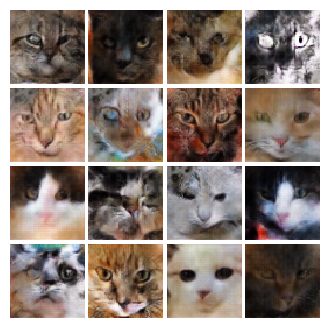


EPOCH:  22
Iter: 10500, D: 0.04882, G:5.272


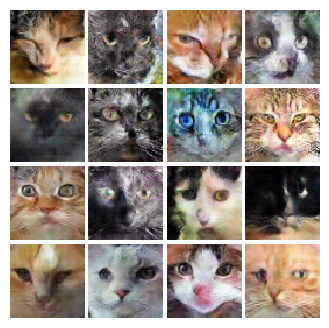


Iter: 10750, D: 0.02719, G:6.107


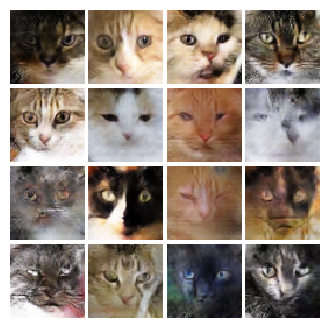


EPOCH:  23
Iter: 11000, D: 1.552, G:5.757


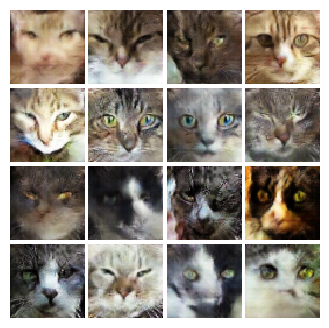


Iter: 11250, D: 0.06968, G:4.535


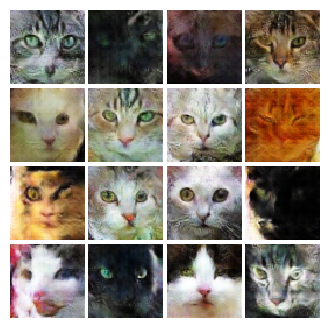


EPOCH:  24
Iter: 11500, D: 0.05288, G:6.336


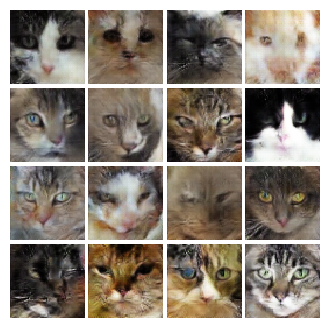


Iter: 11750, D: 0.03472, G:4.769


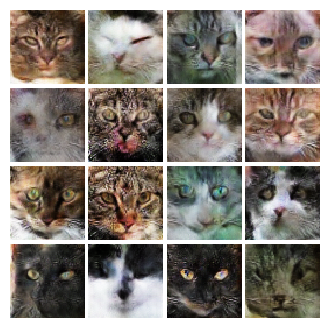


EPOCH:  25
Iter: 12000, D: 0.01081, G:6.217


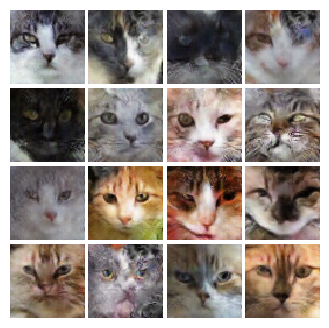


Iter: 12250, D: 0.03759, G:4.632


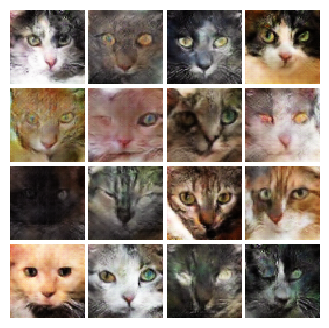


EPOCH:  26
Iter: 12500, D: 0.06883, G:5.411


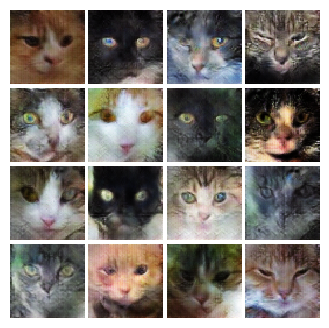


Iter: 12750, D: 0.1028, G:7.321


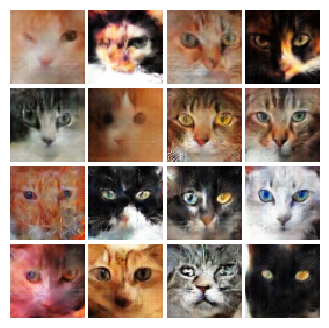


EPOCH:  27
Iter: 13000, D: 0.0226, G:4.862


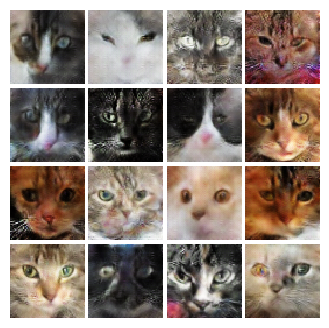


Iter: 13250, D: 0.05503, G:5.252


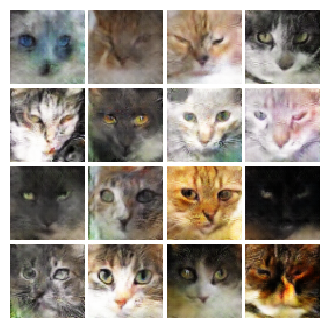


EPOCH:  28
Iter: 13500, D: 0.03912, G:5.689


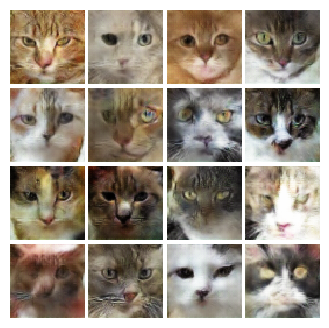


Iter: 13750, D: 0.06263, G:4.898


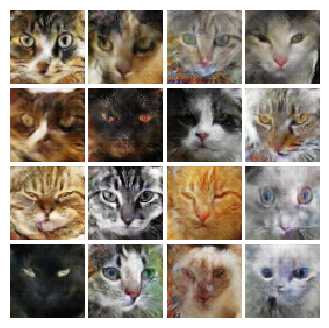


EPOCH:  29
Iter: 14000, D: 0.09803, G:6.752


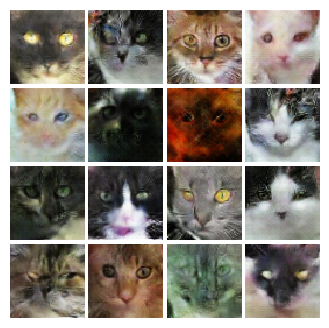


Iter: 14250, D: 0.04107, G:4.294


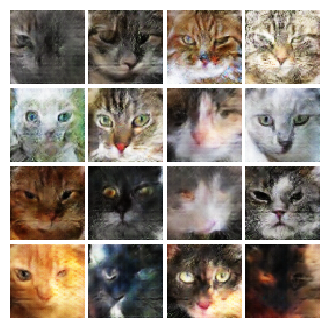


EPOCH:  30
Iter: 14500, D: 0.03548, G:4.661


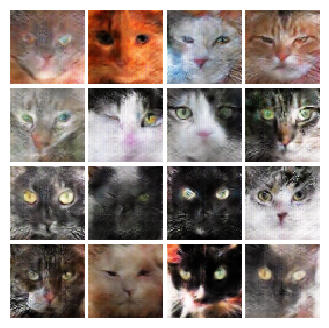


Iter: 14750, D: 0.05583, G:5.943


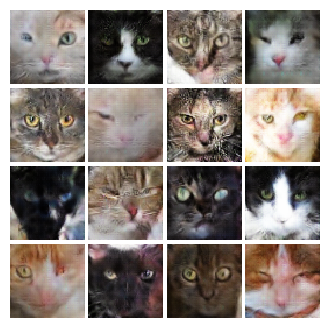


EPOCH:  31
Iter: 15000, D: 0.06132, G:8.24


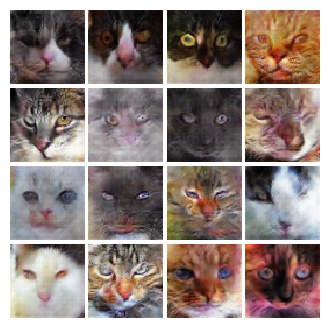


Iter: 15250, D: 0.02922, G:6.315


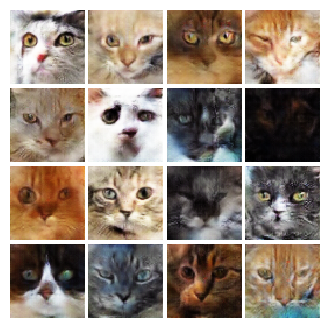


EPOCH:  32
Iter: 15500, D: 0.04859, G:7.236


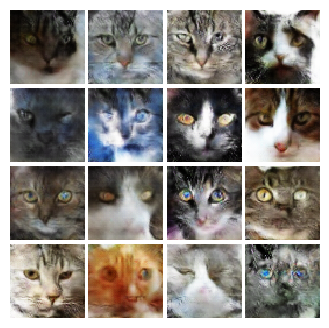


EPOCH:  33
Iter: 15750, D: 0.03181, G:5.979


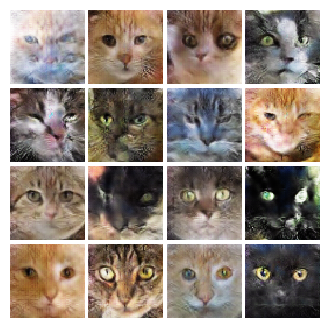


Iter: 16000, D: 0.249, G:6.594


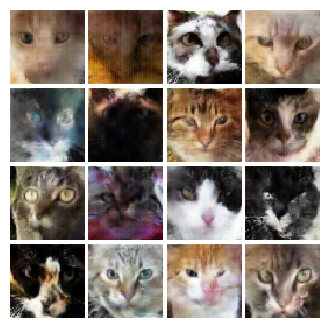


EPOCH:  34
Iter: 16250, D: 0.3396, G:10.21


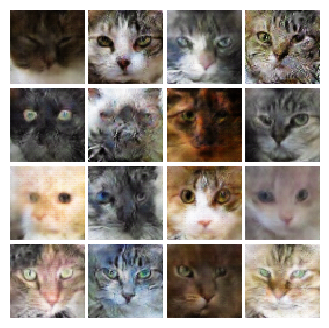


Iter: 16500, D: 0.09362, G:7.328


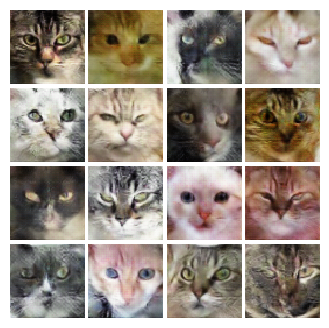


EPOCH:  35
Iter: 16750, D: 0.03738, G:5.904


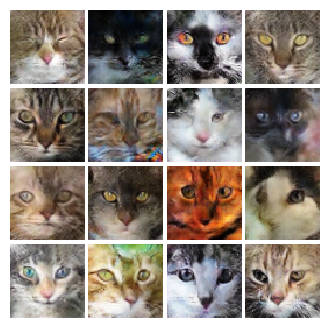


Iter: 17000, D: 0.1094, G:4.297


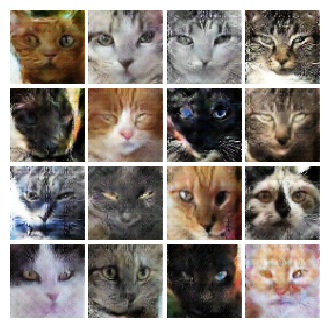


EPOCH:  36
Iter: 17250, D: 0.04028, G:4.801


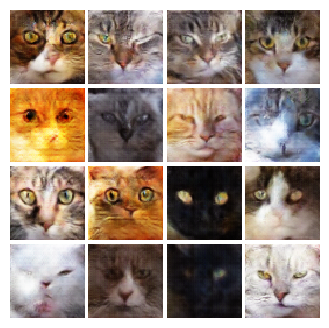


Iter: 17500, D: 0.04526, G:7.371


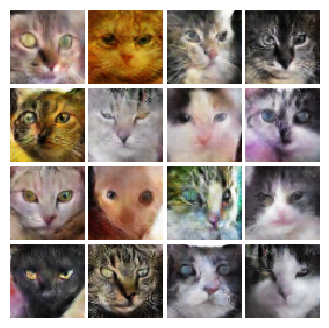


EPOCH:  37
Iter: 17750, D: 1.207, G:5.604


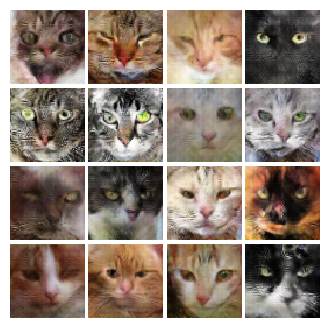


Iter: 18000, D: 0.03559, G:7.526


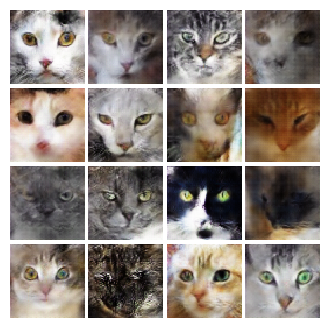


EPOCH:  38
Iter: 18250, D: 0.1903, G:1.918


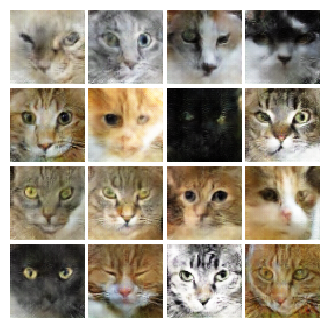


Iter: 18500, D: 0.1555, G:6.57


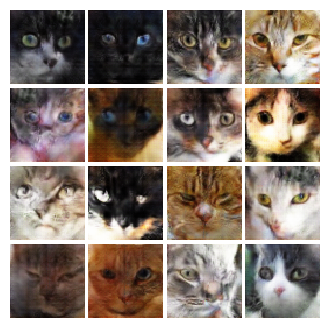


EPOCH:  39
Iter: 18750, D: 0.02385, G:8.366


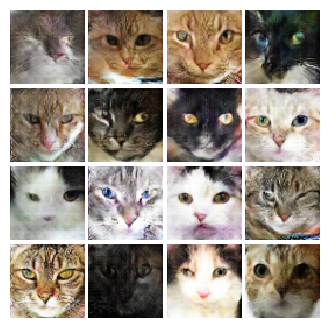


Iter: 19000, D: 0.06296, G:5.863


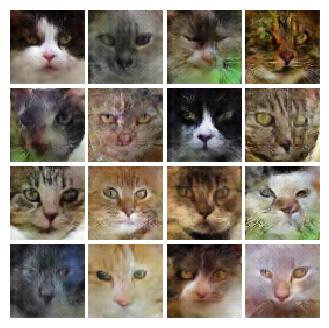


EPOCH:  40
Iter: 19250, D: 0.02647, G:6.953


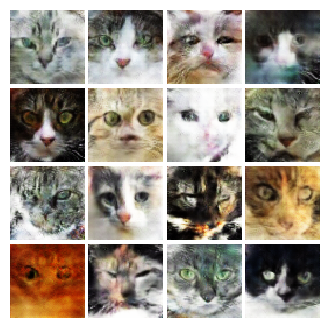


Iter: 19500, D: 0.03458, G:7.133


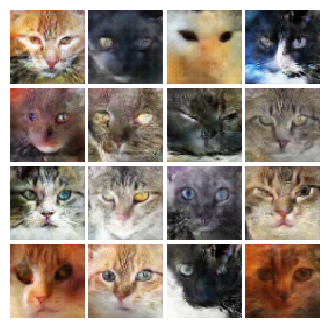


EPOCH:  41
Iter: 19750, D: 0.09135, G:7.779


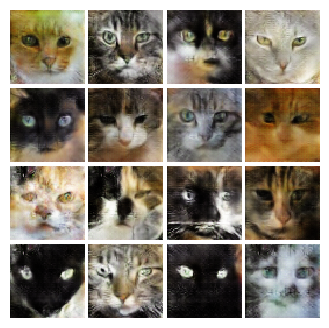


Iter: 20000, D: 0.1549, G:5.626


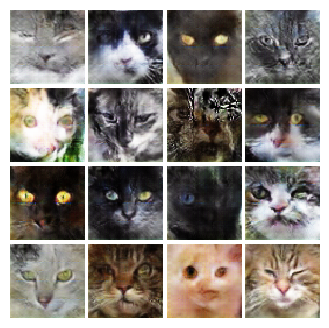


EPOCH:  42
Iter: 20250, D: 0.01791, G:6.502


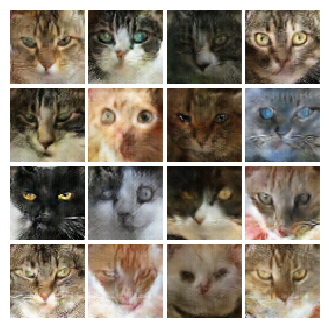


Iter: 20500, D: 0.02045, G:4.949


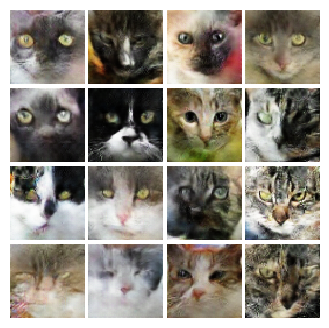


EPOCH:  43
Iter: 20750, D: 0.03164, G:9.9


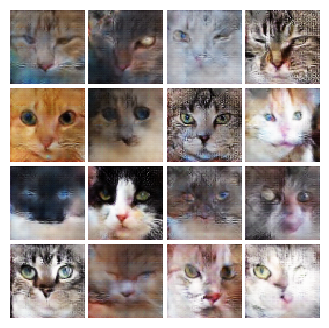


Iter: 21000, D: 0.04074, G:6.512


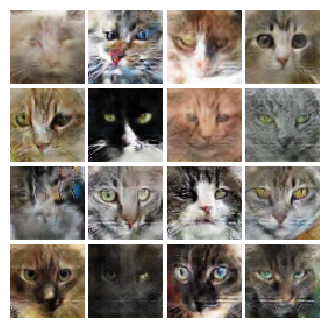


EPOCH:  44
Iter: 21250, D: 0.1604, G:8.876


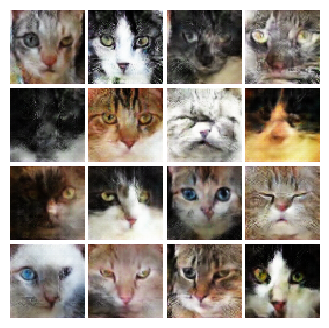


Iter: 21500, D: 0.04647, G:4.539


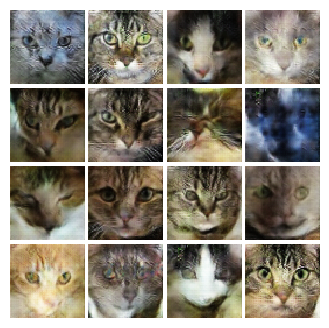


EPOCH:  45
Iter: 21750, D: 0.05556, G:5.496


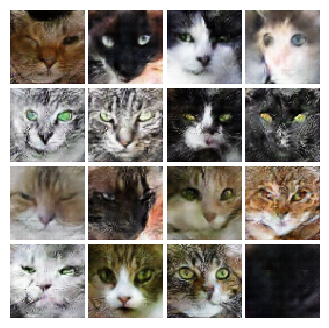


Iter: 22000, D: 0.005076, G:10.39


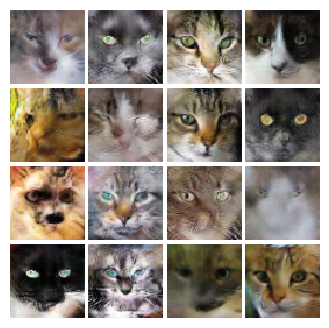


EPOCH:  46
Iter: 22250, D: 0.02266, G:6.17


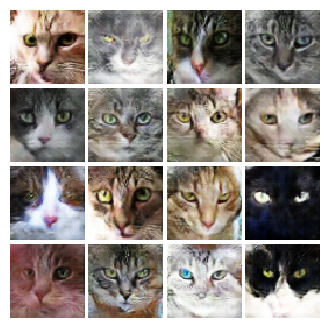


Iter: 22500, D: 0.01199, G:6.718


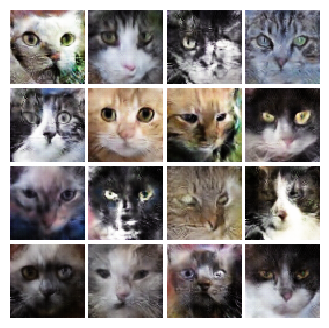


EPOCH:  47
Iter: 22750, D: 0.07098, G:6.533


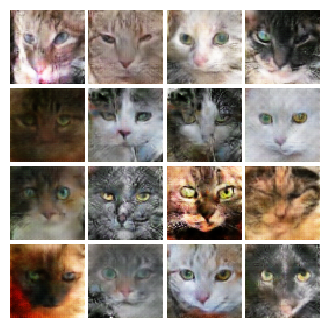


Iter: 23000, D: 0.1477, G:4.318


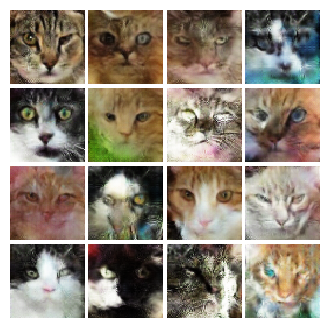


EPOCH:  48
Iter: 23250, D: 0.08327, G:3.852


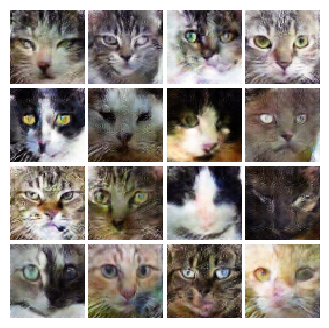


Iter: 23500, D: 0.01228, G:4.851


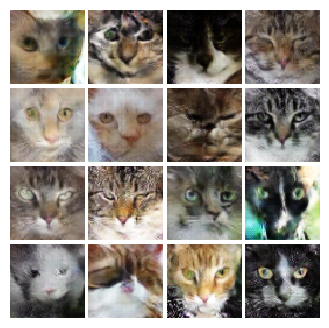


EPOCH:  49
Iter: 23750, D: 0.09454, G:6.856


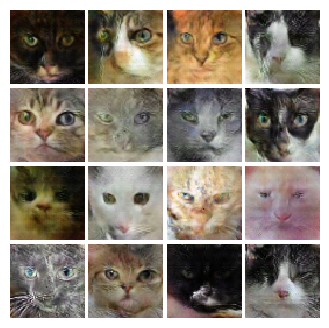

In [ ]:
# original gan
train(D, G, D_optimizer, G_optimizer, discriminator_loss,
          generator_loss, num_epochs=NUM_EPOCHS, show_every=250,
          batch_size=batch_size, train_loader=cat_loader_train, device=device)


### Train LS-GAN

In [ ]:
NOISE_DIM = 100
NUM_EPOCHS = 20
learning_rate = 0.001

In [ ]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [ ]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

In [ ]:
# ls-gan
train(D, G, D_optimizer, G_optimizer, ls_discriminator_loss,
          ls_generator_loss, num_epochs=NUM_EPOCHS, show_every=250,
          batch_size=batch_size, train_loader=cat_loader_train, device=device)

In [ ]:
path = os.getcwd()
path

In [ ]:
# !pip install nbconvert
# !apt-get install texlive texlive-xetex texlive-latex-extra pandoc
# !pip install pypandoc

!jupyter nbconvert --to pdf "/home/nima/RAMIN/HW4/Part1/part1.ipynb"